Animation size has reached 20973951 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


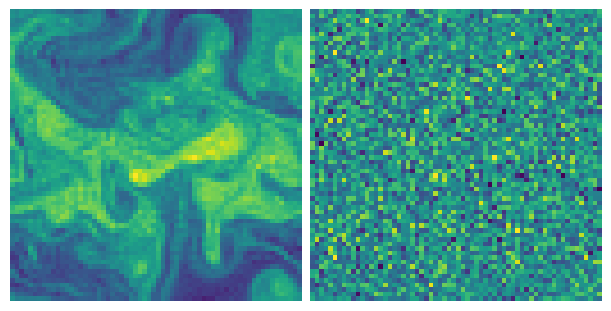

In [ ]:
%matplotlib inline  
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

level = 0 # There are two levels in the data, 0 and 1
cmap = 'viridis' # You can try other cmaps also

fname_truth = 'SQG.npy'

fname_noise = 'inverted_SQG.npy'

data_std = 2660 # Std of the data
truth = np.load(fname_truth)/data_std 
noise = np.load(fname_noise)

fig, ax = plt.subplots(1, 2, figsize=(6,3), constrained_layout=True)
ax[0].axis('off')
ax[1].axis('off')

stds = 3
vmin_truth, vmax_truth = -truth.std()*stds, truth.std()*stds
vmin_noise, vmax_noise = -noise.std()*stds, noise.std()*stds

ims = []
im1 = ax[0].imshow(truth[0,level], cmap=cmap, animated=True, vmin=vmin_truth, vmax=vmax_truth)
im2 = ax[1].imshow(noise[0,level], cmap=cmap, animated=True, vmin=vmin_noise, vmax=vmax_noise)
ims.append(im1)
ims.append(im2)

def update(frame):
    ims[0].set_array(truth[frame, level])
    ims[1].set_array(noise[frame, level])
    return ims

ani = animation.FuncAnimation(
    fig, update, frames=truth.shape[0], interval=10, blit=True
)

HTML(ani.to_jshtml())